In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import pickle
import os
import pandas as pd
import json

from lung_map_utils import utils

%matplotlib inline

In [2]:
fig_size = (8, 8)
color_blur_kernel = (27, 27)
lrg_struct_blur_kernel = (91, 91)

METADATA_FILE = "custom_features/data/metadata_table_all.csv"

img_file = "data/mouse_16.5_20x/LMEX0000000073_acta2_sftpc_sox9/2015-04-029_20X_C57Bl6_E16.5_LMM.14.24.4.46_SOX9_SFTPC_ACTA2_001.tif"
img = cv2.imread(img_file)
img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

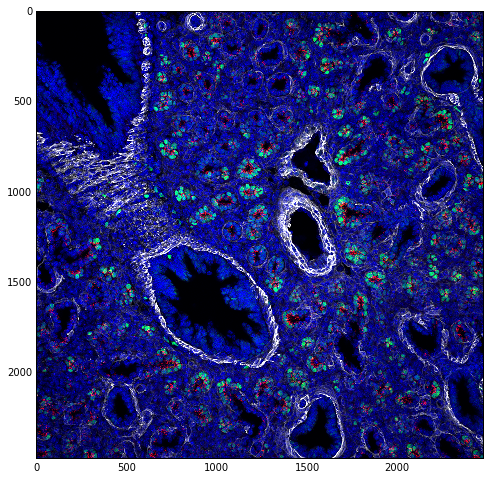

In [3]:
fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))

## Start color threshold candidates

In [4]:
img_blur_c = cv2.GaussianBlur(cv2.cvtColor(img, cv2.COLOR_HSV2RGB), color_blur_kernel, 0)
img_blur_c_hsv = cv2.cvtColor(img_blur_c, cv2.COLOR_RGB2HSV)

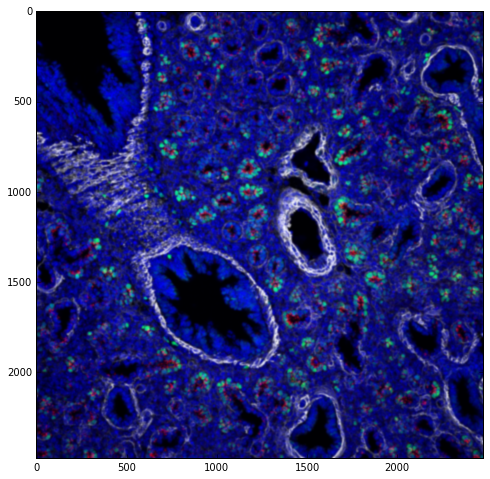

In [5]:
fig = plt.figure(figsize=fig_size)
plt.imshow(img_blur_c)

In [6]:
# create masks from feature colors
mask = utils.create_mask(
    img_blur_c_hsv, 
    [
        'cyan',
        'gray',
        'green',
        'red',
        'violet',
        'white',
        'yellow'
    ]
)

# define kernel used for erosion & dilation
kernel = np.ones((3, 3), np.uint8)

# dilate masks
mask = cv2.dilate(mask, kernel, iterations=3)

# fill holes in mask using contours
mask = utils.fill_holes(mask)

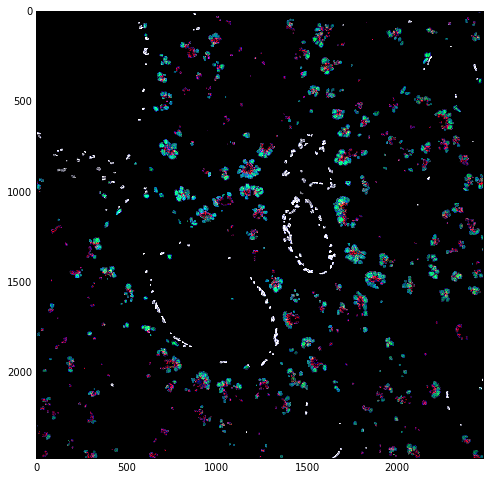

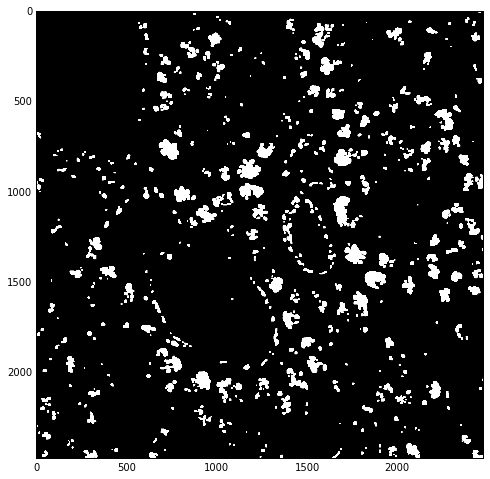

In [7]:
mask_img = cv2.bitwise_and(img, img, mask=mask)

fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(mask_img, cv2.COLOR_HSV2RGB))

fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB))

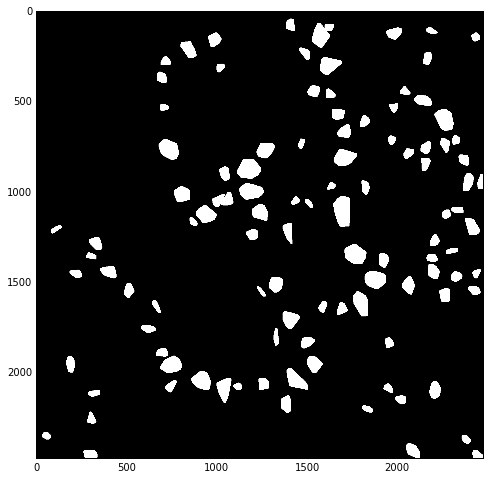

In [8]:
good_contours_color = utils.filter_contours_by_size(mask, min_size=2048)
good_contours_color_final = []

final_good_color = np.zeros(mask.shape, dtype=np.uint8)

for good_c in good_contours_color:    
    hull_c = cv2.convexHull(good_c)
    good_contours_color_final.append(hull_c)
    cv2.drawContours(final_good_color, [hull_c], 0, 255, -1)

fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(final_good_color, cv2.COLOR_GRAY2RGB))

## Start large structure satuation candidates

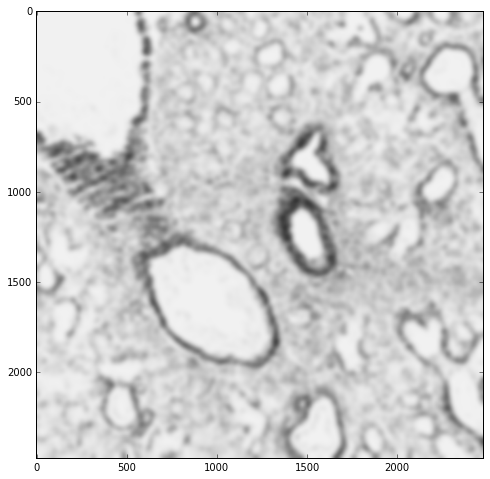

In [9]:
img_s = img[:, :, 1]
img_blur_s_large = cv2.GaussianBlur(img_s, lrg_struct_blur_kernel, 0)

fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(img_blur_s_large, cv2.COLOR_GRAY2RGB))

206 224


lung_map_utils/utils.py:153: RuntimeWarning: underflow encountered in exp
  return height * np.exp(-(x - center) ** 2 / (2 * width ** 2))
lung_map_utils/utils.py:153: RuntimeWarning: underflow encountered in multiply
  return height * np.exp(-(x - center) ** 2 / (2 * width ** 2))
lung_map_utils/utils.py:164: RuntimeWarning: underflow encountered in square
  return (two_gaussian(x, *p) - y) ** 2


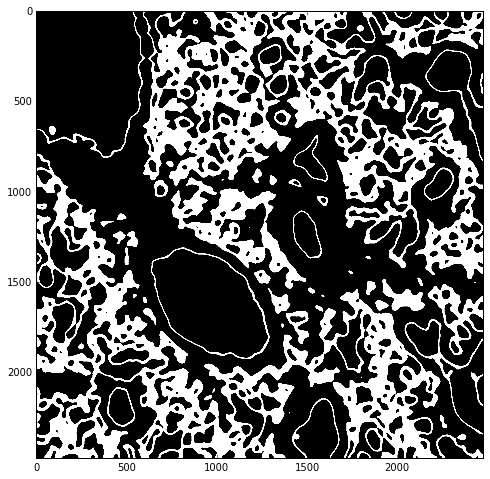

In [10]:
lower_bound, upper_bound = utils.determine_hist_mode(img_blur_s_large)
print lower_bound, upper_bound

mode_s_large = cv2.inRange(img_blur_s_large, lower_bound, upper_bound)

fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(mode_s_large, cv2.COLOR_GRAY2RGB))

In [11]:
cross_strel = cv2.getStructuringElement(cv2.MORPH_CROSS, (3, 3))

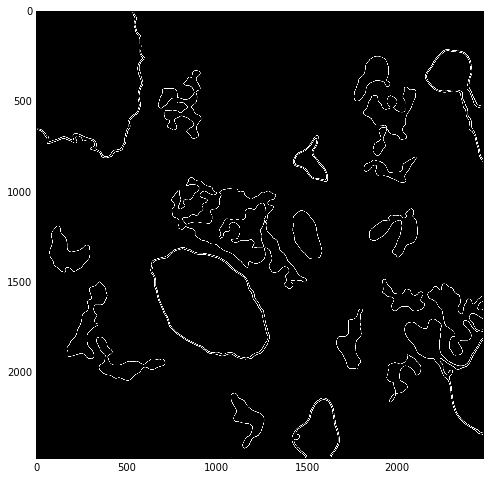

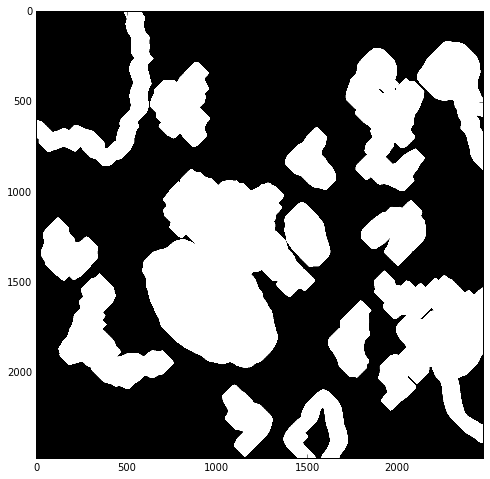

In [12]:
good_contours_large = utils.filter_contours_by_size(mode_s_large, min_size=200*200)
new_good_contours_large = []

orig_good_large = np.zeros(mode_s_large.shape, dtype=np.uint8)
final_good_large = np.zeros(mode_s_large.shape, dtype=np.uint8)

for good_c in good_contours_large:    
    cv2.drawContours(orig_good_large, [good_c], 0, 255, 2)
    
    single_cnt_mask = np.zeros(mode_s_large.shape, dtype=np.uint8)
    cv2.drawContours(single_cnt_mask, [good_c], 0, 255, -1)
    
    # dilate single_cnt_mask up to 91 pixels (~47 times)
    single_cnt_mask = cv2.dilate(single_cnt_mask, cross_strel, iterations=47)
    
    ret, thresh = cv2.threshold(single_cnt_mask, 1, 255, cv2.THRESH_BINARY)
    new_mask, contours, hierarchy = cv2.findContours(
        thresh,
        cv2.RETR_CCOMP,
        cv2.CHAIN_APPROX_SIMPLE
    )
    
    new_good_contours_large.append(contours[0])
    cv2.drawContours(final_good_large, contours, 0, 255, -1)

fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(orig_good_large, cv2.COLOR_GRAY2RGB))

fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(final_good_large, cv2.COLOR_GRAY2RGB))

## Start small structure saturation candidates

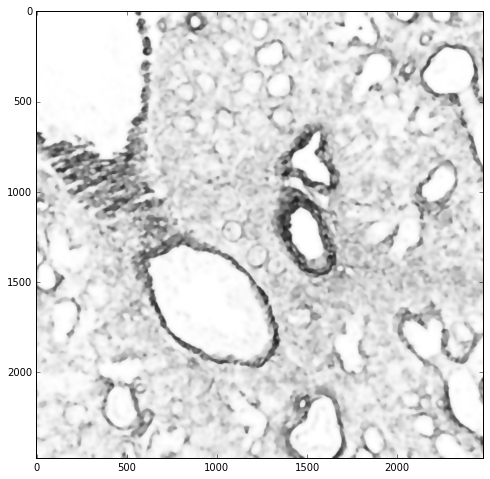

In [13]:
img_blur_s_small = cv2.GaussianBlur(img_s, (31, 31), 0)
img_blur_s_small = cv2.bilateralFilter(img_blur_s_small, 31, 31, 255) #(41, 41), 0)

cnt, bins = np.histogram(img_blur_s_small.flatten(), bins=256, range=(0, 256))

fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(img_blur_s_small, cv2.COLOR_GRAY2RGB))

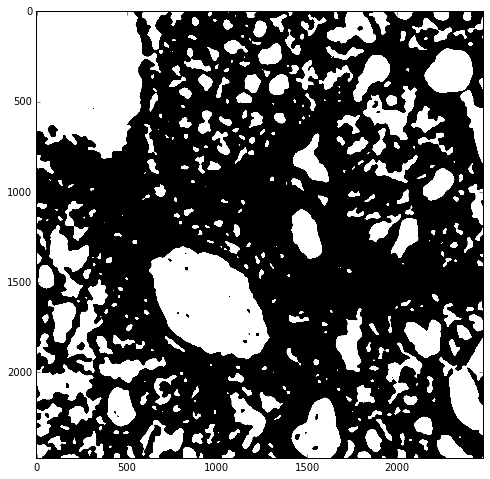

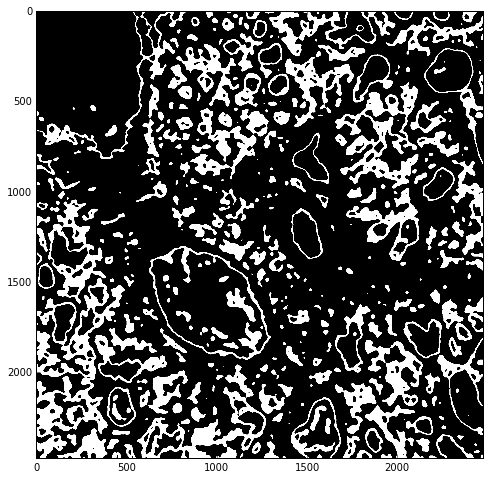

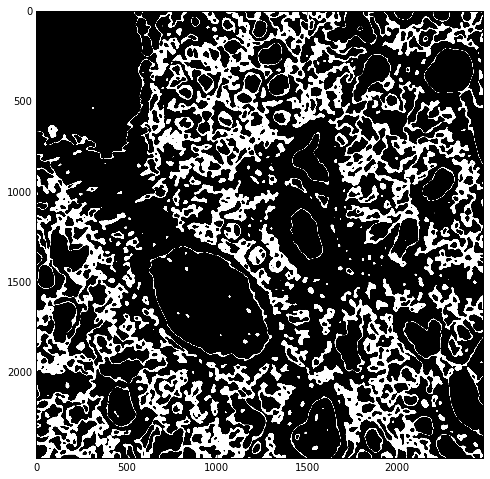

In [14]:
mode_s_small1 = cv2.inRange(img_blur_s_small, 240, 256)
mode_s_small2 = cv2.inRange(img_blur_s_small, 232, 248)
mode_s_small3 = cv2.inRange(img_blur_s_small, 224, 240)


fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(mode_s_small1, cv2.COLOR_GRAY2RGB))

fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(mode_s_small2, cv2.COLOR_GRAY2RGB))

fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(mode_s_small3, cv2.COLOR_GRAY2RGB))

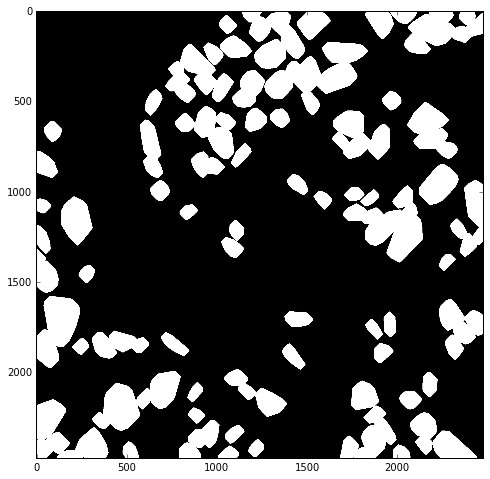

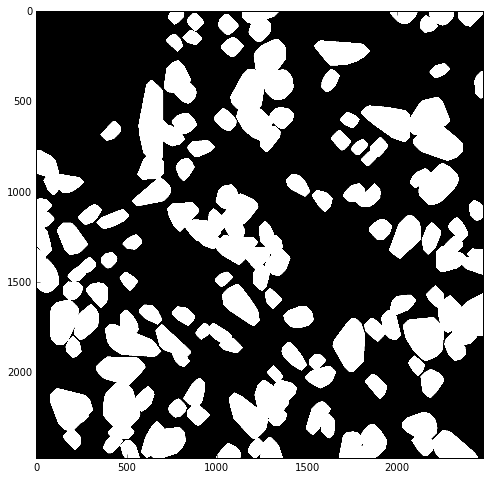

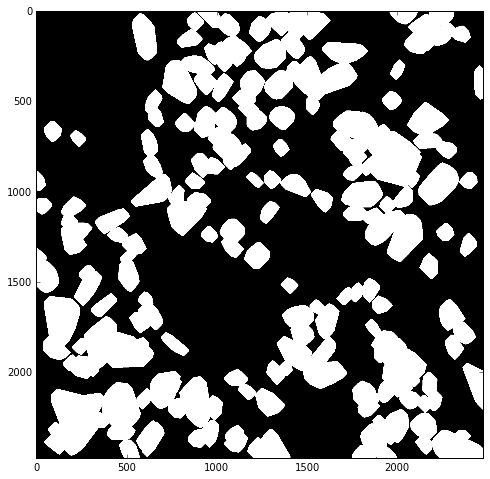

In [15]:
min_size = 32 * 32 * 2
max_size = 200 * 200

good_contours_small1 = utils.filter_contours_by_size(mode_s_small1, min_size=min_size, max_size=max_size)
good_contours_small2 = utils.filter_contours_by_size(mode_s_small2, min_size=min_size, max_size=max_size)
good_contours_small3 = utils.filter_contours_by_size(mode_s_small3, min_size=min_size, max_size=max_size)

small_contour_sets = [good_contours_small1, good_contours_small2, good_contours_small3]

new_good_contours_small = []

for c_set in small_contour_sets:
    final_good_small = np.zeros(img_s.shape, dtype=np.uint8)

    for good_c in c_set:    
        hull_c = cv2.convexHull(good_c)
        
        single_cnt_mask = np.zeros(img_s.shape, dtype=np.uint8)
        cv2.drawContours(single_cnt_mask, [hull_c], 0, 255, -1)
        
        # dilate single_cnt_mask up to 47 pixels (~23 times)
        single_cnt_mask = cv2.dilate(single_cnt_mask, cross_strel, iterations=23)

        ret, thresh = cv2.threshold(single_cnt_mask, 1, 255, cv2.THRESH_BINARY)
        new_mask, contours, hierarchy = cv2.findContours(
            thresh,
            cv2.RETR_CCOMP,
            cv2.CHAIN_APPROX_SIMPLE
        )
        
        cv2.drawContours(final_good_small, contours, 0, 255, -1)

        new_good_contours_small.append(contours[0])

    fig = plt.figure(figsize=fig_size)
    plt.imshow(cv2.cvtColor(final_good_small, cv2.COLOR_GRAY2RGB))

## Merge all candidates

In [16]:
all_contours = new_good_contours_small + new_good_contours_large + good_contours_color_final

In [17]:
len(all_contours)

642

In [18]:
border_contours, non_border_contours = utils.find_border_contours(
    all_contours, 
    img_s.shape[0], 
    img_s.shape[1]
)

In [19]:
len(border_contours), len(non_border_contours)

(80, 562)

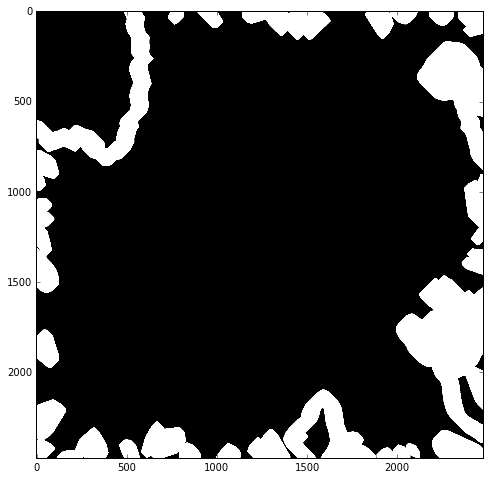

In [20]:
# display only the border contours
open_c_mask = np.zeros(img_s.shape, dtype=np.uint8)

for c in border_contours:    
    cv2.drawContours(open_c_mask, [c], 0, 255, cv2.FILLED)
    
fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(open_c_mask, cv2.COLOR_GRAY2RGB))

In [21]:
# fill the border contours
filled_border_contours =[]

for c in border_contours:
    filled_mask = utils.fill_border_contour(c, img_s.shape)
    
    new_mask, contours, hierarchy = cv2.findContours(
        filled_mask,
        cv2.RETR_CCOMP,
        cv2.CHAIN_APPROX_SIMPLE
    )

    filled_border_contours.append(contours[0])

bottom
5847
(1575, 2474)
right
4365
(2474, 1891)
right
3063
(2474, 589)
left
9289
(0, 607)


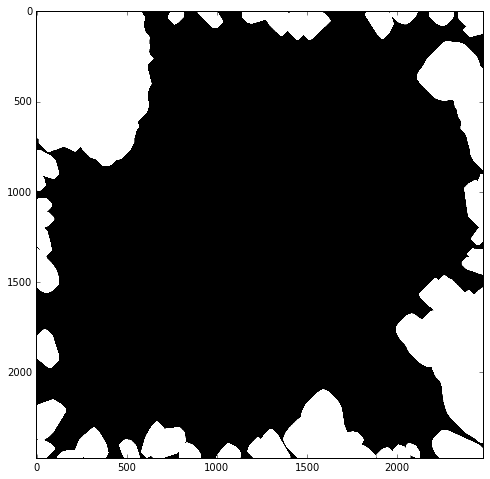

In [22]:
filled_c_mask = np.zeros(img_s.shape, dtype=np.uint8)

for c in filled_border_contours:    
    cv2.drawContours(filled_c_mask, [c], 0, 255, cv2.FILLED)
    
fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(filled_c_mask, cv2.COLOR_GRAY2RGB))

In [25]:
# recombine the filled border contours and non-border contours
all_contours = filled_border_contours + non_border_contours

In [26]:
len(all_contours)

642

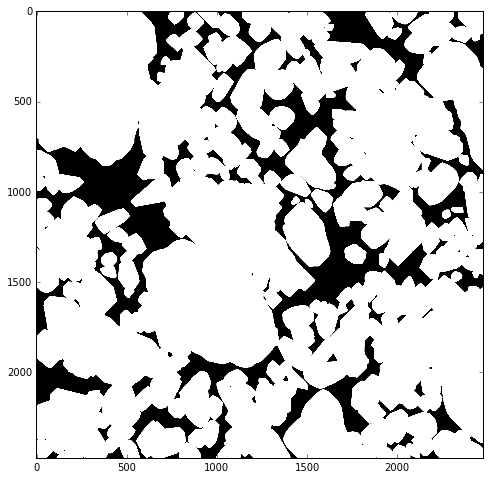

In [27]:
filled_c_mask = np.zeros(img_s.shape, dtype=np.uint8)

for c in all_contours:    
    cv2.drawContours(filled_c_mask, [c], 0, 255, cv2.FILLED)
    
fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(filled_c_mask, cv2.COLOR_GRAY2RGB))

In [28]:
all_rects = []

for c in all_contours:
    all_rects.append(cv2.boundingRect(c))

In [29]:
len(all_rects)

642

In [30]:
rect_combos = []

for i, r1 in enumerate(all_rects[:-1]):
    a1 = r1[2] * r1[3]
    
    for j, r2 in enumerate(all_rects[i+1:]):
        max_x0 = max([r1[0], r2[0]])
        min_x1 = min([r1[0]+r1[2], r2[0]+r2[2]])
        
        if min_x1 < max_x0:
            continue
        
        max_y0 = max([r1[1], r2[1]])
        min_y1 = min([r1[1]+r1[3], r2[1]+r2[3]])
        
        if min_y1 < max_y0:
            continue
        
        a_int = (min_x1 - max_x0) * (min_y1 - max_y0)
        
        if a_int >= 0.7 * a1:
            a2 = r2[2] * r2[3]
            
            if a_int > 0.7 * a2:
                rect_combos.append(set([i, i+j+1]))

In [31]:
len(rect_combos)

226

In [32]:
i = 0

while i < len(rect_combos[:-1]):
    j = i + 1
    
    while j < len(rect_combos):
        if len(rect_combos[i].intersection(rect_combos[j])) > 0:
            rect_combos[i] = rect_combos[i].union(rect_combos[j])
            rect_combos.remove(rect_combos[j])
            j -= 1
        j += 1
    i += 1

In [33]:
len(rect_combos)

116

In [34]:
c_combo_list = []

for c in rect_combos:
    c_combo_list.extend(list(c))

In [35]:
len(c_combo_list)

285

In [36]:
final_combined_contours = []

for c in rect_combos:
    c_idx_list = list(c)
    c_list = []
    
    for ci in c_idx_list:
        c_list.append(all_contours[ci])
    
    final_combined_contours.append(utils.find_contour_union(c_list, img_s.shape))

In [37]:
for i, c in enumerate(all_contours):
    if i in c_combo_list:
        continue
    
    c_mask = np.zeros(img_s.shape, dtype=np.uint8)
    cv2.drawContours(c_mask, [c], 0, 255, cv2.FILLED)
    final_combined_contours.append(c_mask)

In [38]:
len(final_combined_contours)

473

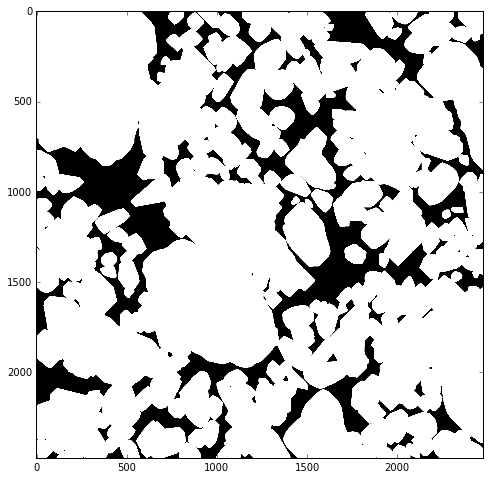

In [39]:
# display only the border contours
final_c_mask = np.zeros(img_s.shape, dtype=np.uint8)

for c in final_combined_contours:
    final_c_mask = cv2.bitwise_or(final_c_mask, c)
    
fig = plt.figure(figsize=fig_size)
plt.imshow(cv2.cvtColor(final_c_mask, cv2.COLOR_GRAY2RGB))

In [40]:
final_combined_rects = []

for c in final_combined_contours:
    final_combined_rects.append(cv2.boundingRect(c))

In [41]:
len(final_combined_rects)

473

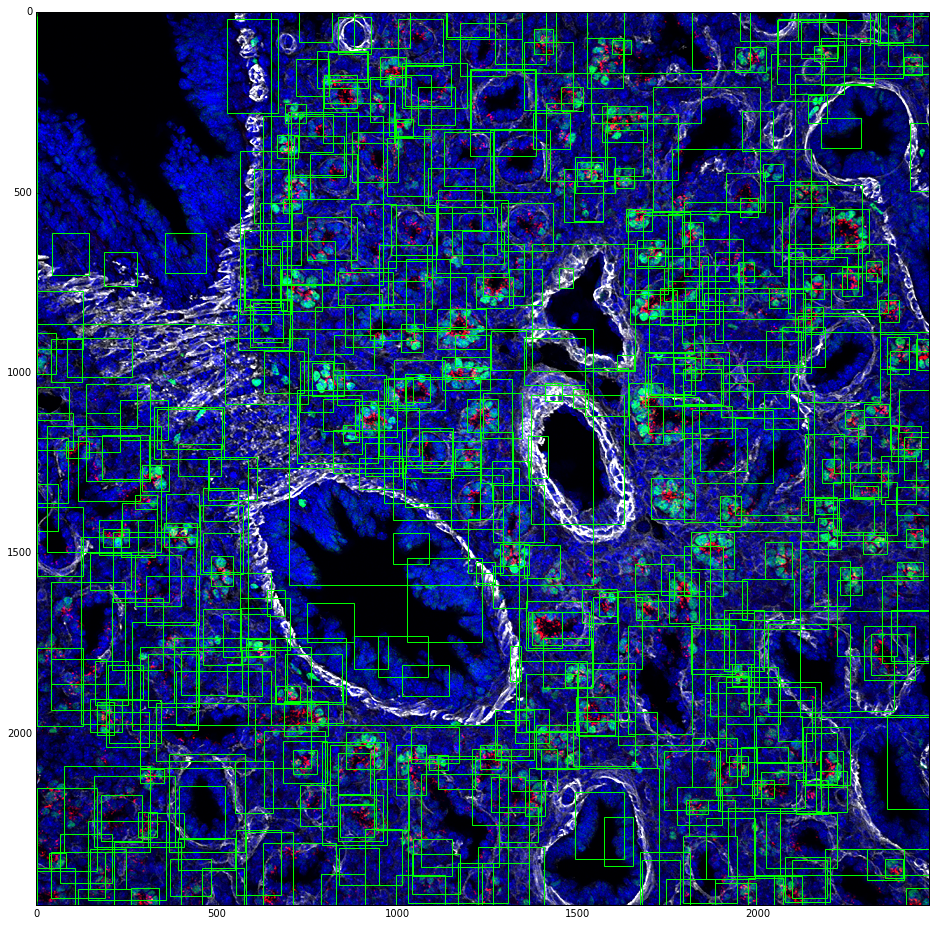

In [42]:
utils.plot_rectangles(img, rectangles=final_combined_rects)

## Classify final candidates

In [43]:
source_file_name = os.path.basename(img_file)
cached = True
classifier = 'svc'
train_dir = "/home/swhite/Projects/lung_map/data/mouse_16.5_20x/LMEX0000000073_acta2_sftpc_sox9/exp73_trained_models/poly/"

cached_model_file = "svc_custom_masked.fit" # ".".join([classifier, 'fit'])
cached_model_path = "/".join([train_dir, cached_model_file])

# load training model from cached model if cached is True,
# else build a new one from training data
if cached:
    try:
        trained_model = pickle.load(open(cached_model_path, 'rb'))
        class_map = utils.get_class_map(train_dir)
    except Exception as e:
        print e
        print "Failed to load cached training model, building a new one..."
        trained_model = None
        class_map = None
else:
    trained_model = None
    class_map = None

if trained_model is None:
    training_data, class_map = utils.load_training_data(train_dir)
    print "Loaded training data"

    trained_model = utils.build_trained_model(training_data, classifier=classifier)
    print "Loaded trained model"

    pickle.dump(trained_model, open(cached_model_path, 'wb'))

In [44]:
class_map

{1: 'background',
 2: 'blood_vessel',
 3: 'bronchiole',
 4: 'distal_acinar_tubule',
 5: 'proximal_acinar_tubule'}

In [45]:
training_data.head()

NameError: name 'training_data' is not defined

In [47]:
input_dicts = []

for i, c in enumerate(final_combined_contours):
    input_dicts.append(
        {
            'rect_index': i,
            'region': None,
            'model': trained_model,
            'class_map': class_map,
            'custom': True,
            'hsv_img': img,
            'contour_mask': c
        }
    )

In [48]:
results = []
counter = 0

for i in input_dicts:
    result = utils.predict(i)
    
    results.append(result)
    
    if counter % 20 == 0:
        print "%.2f" % (float(counter) / len(final_combined_rects))
    
    counter += 1

print 'done'

0.00
0.04
0.08
0.13
0.17
0.21
0.25
0.30
0.34
0.38
0.42
0.47
0.51
0.55
0.59
0.63
0.68
0.72
0.76
0.80
0.85
0.89
0.93
0.97
done


In [49]:
final_combined_rects[32], results[32]

((2134, 1999, 85, 141),
 (32,
  'distal_acinar_tubule',
  [('distal_acinar_tubule', 0.88711175358874306),
   ('proximal_acinar_tubule', 0.10169165595660799),
   ('bronchiole', 0.0071248709550018278),
   ('blood_vessel', 0.0026840186418878357),
   ('background', 0.0013877008577593605)]))

In [72]:
final_final_rects = []
final_final_rect_classes = []

for r in results:
    if r[1] == 'background' or r[1] is None or r[2] is None:
        continue
    
    max_prob = 0.0
    
    for p in r[2]:
        if p[1] > max_prob:
            max_prob = p[1]
    
    if max_prob > 0.7:
        final_final_rects.append(final_combined_rects[r[0]])
        final_final_rect_classes.append(r)

In [73]:
len(final_final_rects)

211

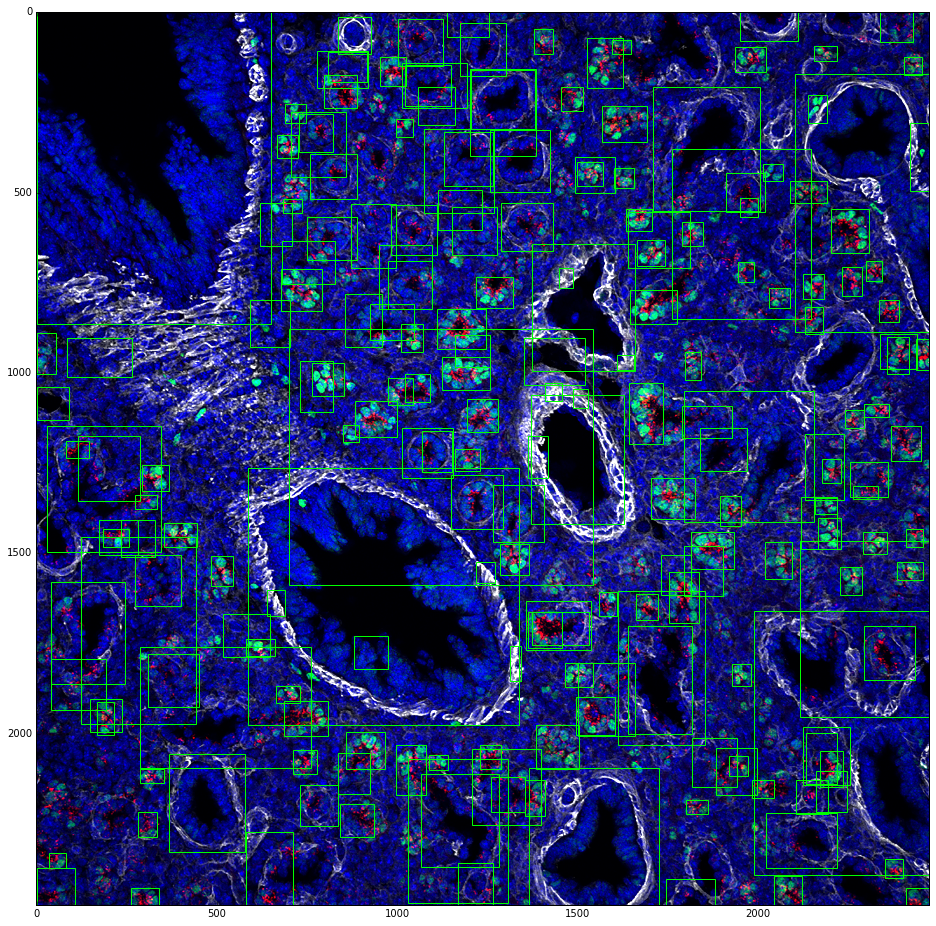

In [74]:
utils.plot_rectangles(img, rectangles=final_final_rects)

In [75]:
final_bronchiole_rects = []
final_blood_vessel_rects = []
final_prox_ac_tub_rects = []
final_dist_ac_tub_rects = []
final_muscle_wall_rects = []
low_prob_bronchiole_rects = []
low_prob_blood_vessel_rects = []
low_prob_prox_ac_tub_rects = []
low_prob_dist_ac_tub_rects = []

for r in results:
    if r[1] == 'background' or r[1] is None or r[2] is None:
        continue
    
    max_prob = 0.0
    
    for p in r[2]:
        if p[1] > max_prob:
            max_prob = p[1]
    
    if max_prob > 0.7:
        if r[1] == 'bronchiole':
            final_bronchiole_rects.append(final_combined_rects[r[0]])
        elif r[1] == 'proximal_acinar_tubule':
            final_prox_ac_tub_rects.append(final_combined_rects[r[0]])
        elif r[1] == 'distal_acinar_tubule':
            final_dist_ac_tub_rects.append(final_combined_rects[r[0]])
        elif r[1].endswith('blood_vessel'):
            final_blood_vessel_rects.append(final_combined_rects[r[0]])
        elif r[1] == ('muscle_wall'):
            final_muscle_wall_rects.append(final_combined_rects[r[0]])
    else:
        if r[1] == 'bronchiole':
            low_prob_bronchiole_rects.append(final_combined_rects[r[0]])
        elif r[1] == 'proximal_acinar_tubule':
            low_prob_prox_ac_tub_rects.append(final_combined_rects[r[0]])
        elif r[1] == 'distal_acinar_tubule':
            low_prob_dist_ac_tub_rects.append(final_combined_rects[r[0]])
        elif r[1].endswith('blood_vessel'):
            low_prob_blood_vessel_rects.append(final_combined_rects[r[0]])

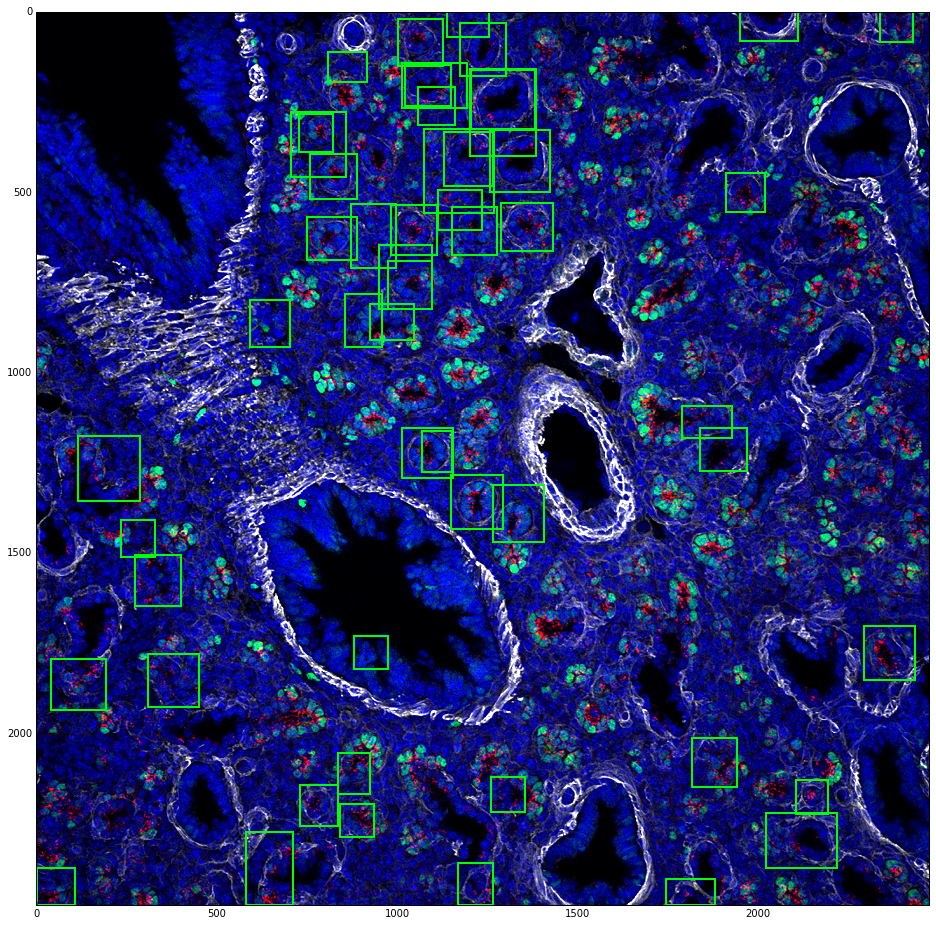

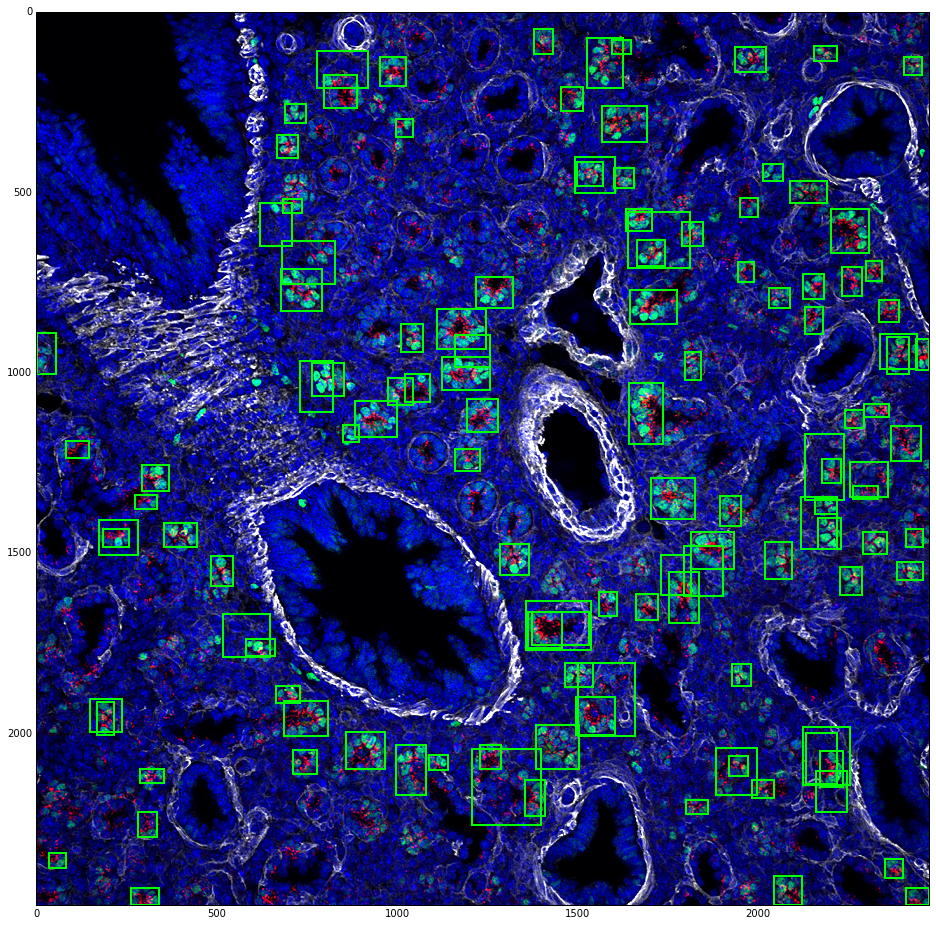

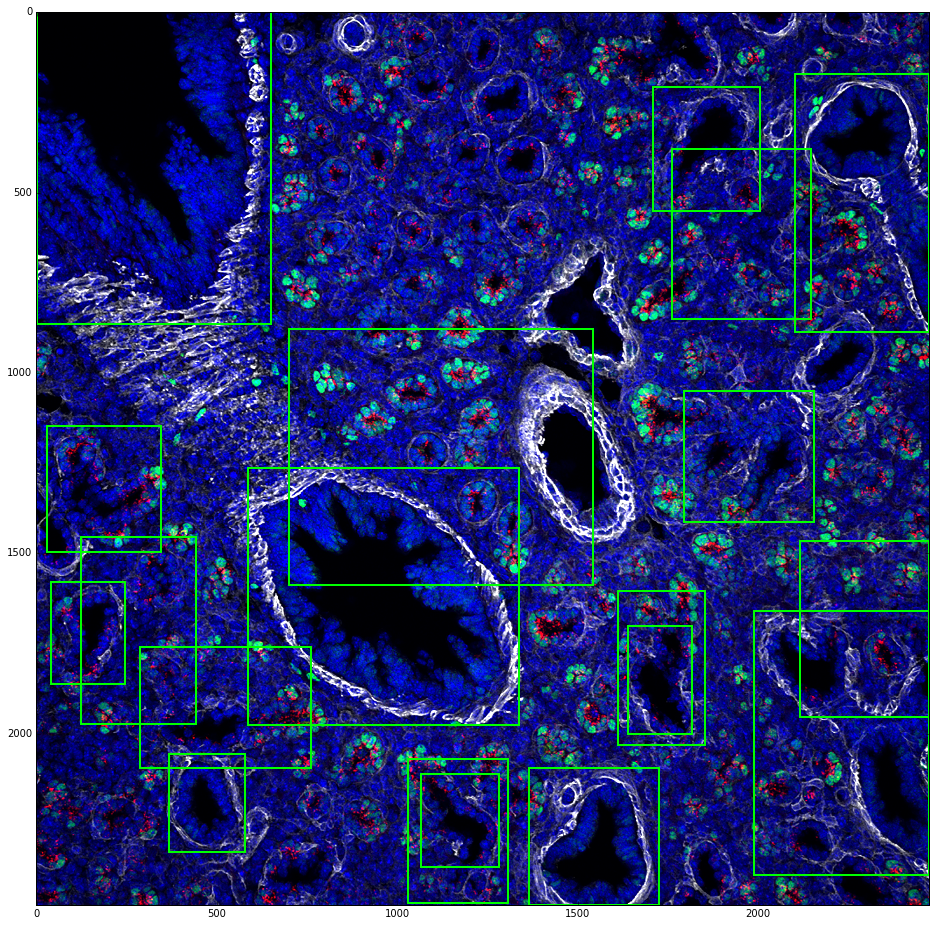

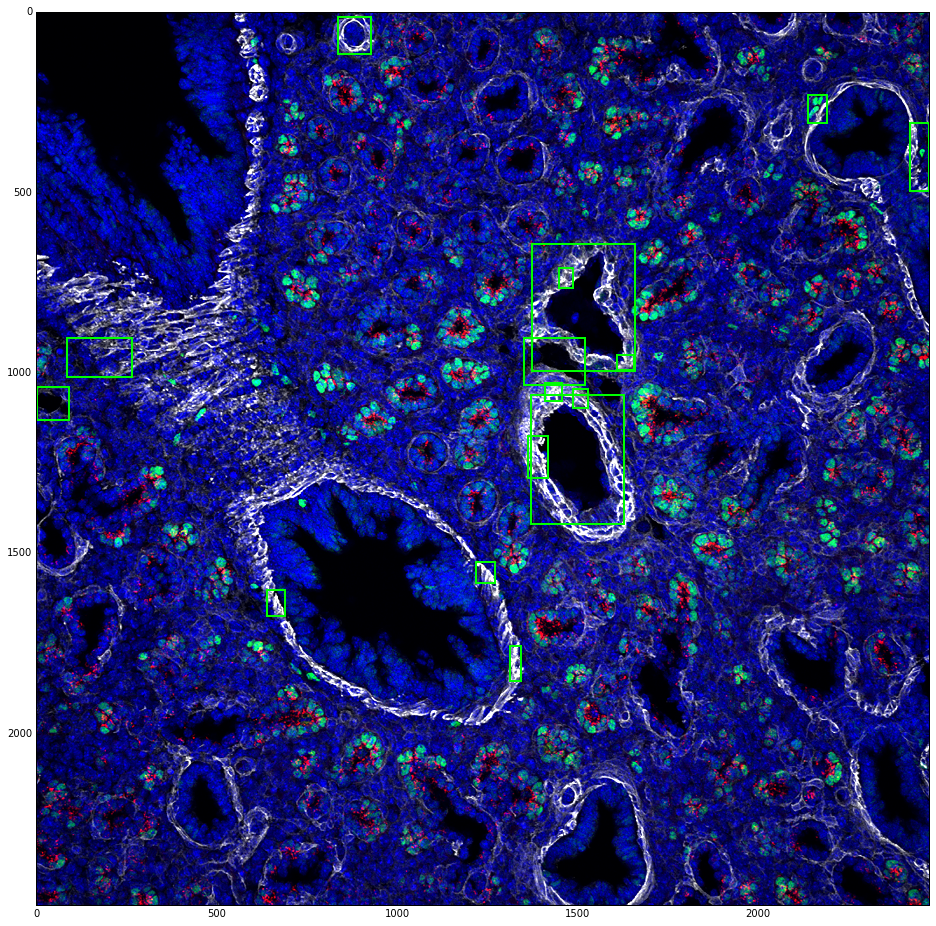

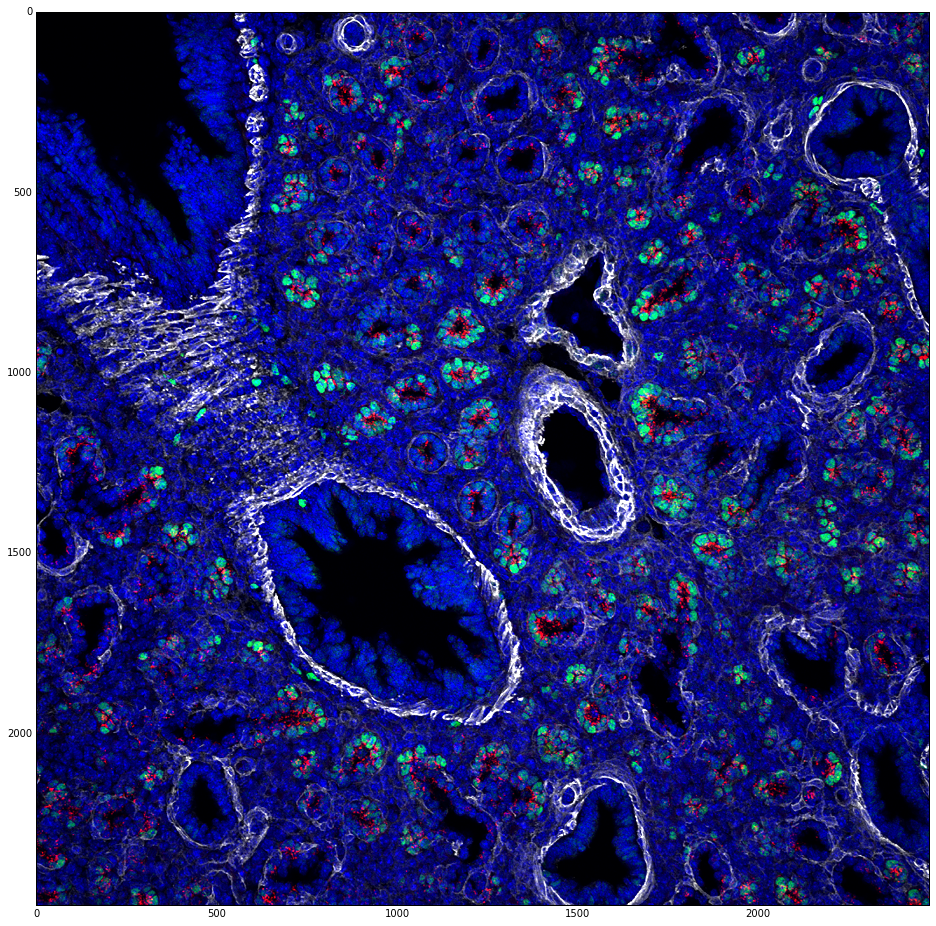

In [76]:
utils.plot_rectangles(img, rectangles=final_prox_ac_tub_rects, lw=2)
utils.plot_rectangles(img, rectangles=final_dist_ac_tub_rects, lw=2)
utils.plot_rectangles(img, rectangles=final_bronchiole_rects, lw=2)
utils.plot_rectangles(img, rectangles=final_blood_vessel_rects, lw=2)
utils.plot_rectangles(img, rectangles=final_muscle_wall_rects, lw=2)

In [71]:
import re

In [88]:
rect_json = {
    'image': os.path.basename(img_file),
    'bounding_box': []
}

for i, r in enumerate(final_final_rects):
    rect_json['bounding_box'].append(
        {
            'x1': r[0],
            'x2': r[0] + r[2],
            'y1': r[1],
            'y2': r[1] + r[3],
            'predicted_ontology': final_final_rect_classes[i][1],
            'reviewed_ontology': '',
            'reviewer': ''
        }
    )
    
    match = re.search('(.+)\.(.+)$', os.path.basename(img_file))
        
    output_filename = "".join(
        [
            match.groups()[0],
            '_',
            str(r[0]),
            '_',
            str(r[1]),
            '.',
            match.groups()[1]
        ]
    )
        
    region_img = img[r[1]:r[1] + r[3], r[0]:r[0] + r[2], :]

    cv2.imwrite("/". join(['example_candidates', output_filename]), cv2.cvtColor(region_img, cv2.COLOR_HSV2BGR))

In [68]:
json.dump(rect_json, open('lm_example.json', 'w'), indent=2)